## 분류별 데이터 확인

In [60]:
import pandas as pd
from collections import Counter
from wordcloud import WordCloud
import matplotlib.pyplot as plt
%matplotlib inline
import platform
from matplotlib import font_manager, rc
import pandas as pd
import numpy as np

In [69]:
# 한글 문제
# matplotlit의 기본 폰트에서 한글 지원되지 않기 때문에
# matplotlib의 폰트 변경 필요

from matplotlib import font_manager, rc
plt.rcParams['axes.unicode_minus'] = False

if platform.system() == 'Darwin':  # 맥OS 
    rc('font', family='AppleGothic')
    font_path = '/System/Library/Fonts/AppleGothic.ttf' 
elif platform.system() == 'Windows':  # 윈도우
    path = "c:/Windows/Fonts/malgun.ttf"
    font_name = font_manager.FontProperties(fname=path).get_name()
    rc('font', family=font_name)
else:
    print('Unknown system...  sorry~~~')

In [62]:
train_df = pd.read_csv('../data/train.csv')
test_df = pd.read_csv('../data/test.csv')

In [63]:
train_df.head()

,ID,분류,제목,키워드
0,TRAIN_00000,문화:전시_공연,"용인문화재단, 인문학 콘서트 ‘당신이 모르는 뮤지컬 이야기Ⅳ’ 개최","용인문화재단,인문학,콘서트,뮤지컬,이야기,개최,인문학,콘서트,뮤지컬,이야기,용인문화..."
1,TRAIN_00001,지역,"용인 농촌테마파크, 7~8월 단체체험객 체험료 지원","용인,농촌,테마파크,단체,체험객,체험료,지원,15일,체험일,기준,용인시통합예약사이트..."
2,TRAIN_00002,지역,"용인시, 노후주택 에너지 성능 개선 신청 18일까지 연장","용인시,노후,주택,에너지,성능,개선,신청,연장,용인시청,용인시,노후,건축물,환경친화..."
3,TRAIN_00003,지역,"수원 용인 고양시,‘특례시’로 지정 도시경쟁력 증가 기대","수원,용인,고양시,특례시,지정,도시경쟁력,증가,경기,도내,인구,수원,고양,용인시,특..."
4,TRAIN_00004,국제,"용인시, 스페인 미국 국제명예자문관 위촉 대외홍보 지원 역할","용인시,스페인,미국,국제,명예,자문관,위촉,역할,대외,홍보,지원,용인시,권태면,주코..."


In [64]:
train_df.분류.unique()

array(['문화:전시_공연', '지역', '국제', '정치:선거', '경제:금융_재테크', '사회:의료_건강',
       '정치:행정_자치', '정치:국회_정당', '스포츠:축구', '경제:서비스_쇼핑', '경제:부동산',
       '사회:교육_시험', '사회:미디어', 'IT_과학:인터넷_SNS', '사회:장애인', '사회:노동_복지',
       '경제:경제일반', '정치:정치일반', '사회:사회일반', '문화:문화일반', '경제:취업_창업', '사회:사건_사고',
       '스포츠:올림픽_아시안게임', '사회:환경', '정치:외교', '경제:산업_기업', '스포츠:골프', '경제:유통',
       'IT_과학:모바일', '사회:여성', '사회:날씨', '문화:방송_연예', 'IT_과학:IT_과학일반',
       '경제:반도체', '경제:자원', '문화:종교', '경제:자동차', '경제:무역', 'IT_과학:콘텐츠',
       '경제:증권_증시', 'IT_과학:과학', '경제:외환', '문화:요리_여행', '정치:청와대', '문화:출판',
       '문화:미술_건축', '문화:음악', '스포츠:농구_배구', '문화:생활', '정치:북한', '스포츠:야구',
       '문화:학술_문화재', 'IT_과학:보안', '문화:영화', '스포츠:월드컵', '스포츠:스포츠일반'],
      dtype=object)

### 문화:전시_공연

In [73]:
df = train_df[train_df['분류'] == '문화:전시_공연']

In [74]:
keywords = df['키워드'].str.split(',')

all_keywords = [keyword for sublist in keywords for keyword in sublist]

keyword_counts = Counter(all_keywords)

<Figure size 1000x500 with 0 Axes>

(-0.5, 799.5, 399.5, -0.5)

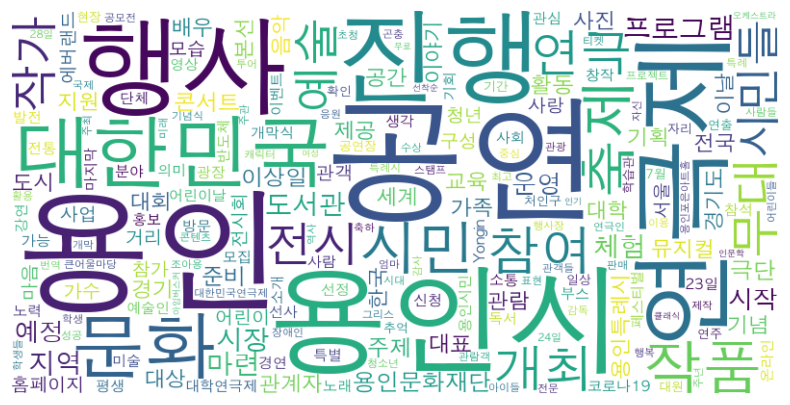

In [75]:
# 워드 클라우드 생성
wordcloud = WordCloud(font_path=font_path, width=800, height=400, background_color='white').generate_from_frequencies(keyword_counts)

# 워드 클라우드 시각화
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [82]:
N = 3
filtered_keywords = {keyword: count for keyword, count in keyword_counts.items() if count <= N}

print(f"{N}개 이하의 키워드:")
for keyword, count in filtered_keywords.items():
    print(f"{keyword}: {count}")


3개 이하의 키워드:
고양군: 2
삼중규제: 1
광역권한: 1
원자: 3
력수소: 2
남효선: 2
기회발전특구: 3
고향사랑e음시스템: 2
과천토리: 2
외국노동자: 1
266명: 1
533명: 2
ㆍ인: 1
본국: 2
고양4: 2
2122명: 1
000평: 2
하수처리량: 3
부영양화: 3
하수행정: 3
해충퇴치기설치: 1
외식사업: 2
이목집중: 2
만수정: 3
표상: 1
입지전: 1
중퇴: 1
단돈: 2
상경: 2
절치부심: 2
기절: 1
고창산: 1
특제: 1
장어구이: 2
김대표: 1
보습크림: 1
온돌: 1
밀알: 2
라이프특집: 1
축구광: 1
홍명보: 1
홍명보장학재단: 2
키다리: 3
용인기후행동: 3
비교표: 1
용인시민안: 1
불수용: 2
기본조례안: 3
총칙: 1
용인시청삼거리: 2
130초: 2
송담대삼거리: 3
천리삼거리: 3
지역박물관: 1
용인동백지구: 1
구석기문화층: 1
역사인물실: 1
역사문화실: 1
역사실: 1
1전시실: 1
선사시대: 2
2전시실: 1
서리상반고려백자요지: 1
세거성: 1
성장과정: 1
일반시민들: 2
통ㆍ이장: 2
청소년지도위원: 3
깐다: 2
삼원하우징: 1
116면: 2
도돌: 2
몸놀: 2
놀이도구: 2
놀이기지: 2
문화도시용: 1
충전시간: 3
권선대림아파트: 3
간편: 2
교복지원비: 1
노면청소기: 2
등기수령: 2
60면: 2
300회: 1
청년지원사업: 1
포스코건설은경기도: 1
ㆍ서: 3
종합우: 1
food-related: 2
Chodam: 2
mulberry: 1
extract: 1
Daesang: 1
sauces: 1
Eurobake: 1
booths.: 2
presen: 1
consum: 1
cutting: 3
richer.: 1
oducts: 1
고은정: 2
이상백: 2
경기도소상공인연합회장: 1
원장직무대행: 1
시장방문: 1
답네: 1
김정진: 3
지노믹스: 3
건강체력교실: 3
진로・진학: 1
체・덕・지: 1
bi: 2
Jwahang-ri: 1
Seogunae-ro: 1
N

### 전체 워드클라우드

In [93]:
categories = [
    '문화:전시_공연', '지역', '국제', '정치:선거', '경제:금융_재테크',
    '사회:의료_건강', '정치:행정_자치', '정치:국회_정당', '스포츠:축구',
    '경제:서비스_쇼핑', '경제:부동산', '사회:교육_시험', '사회:미디어',
    'IT_과학:인터넷_SNS', '사회:장애인', '사회:노동_복지', '경제:경제일반',
    '정치:정치일반', '사회:사회일반', '문화:문화일반', '경제:취업_창업',
    '사회:사건_사고', '스포츠:올림픽_아시안게임', '사회:환경', '정치:외교',
    '경제:산업_기업', '스포츠:골프', '경제:유통', 'IT_과학:모바일',
    '사회:여성', '사회:날씨', '문화:방송_연예', 'IT_과학:IT_과학일반',
    '경제:반도체', '경제:자원', '문화:종교', '경제:자동차', '경제:무역',
    'IT_과학:콘텐츠', '경제:증권_증시', 'IT_과학:과학', '경제:외환',
    '문화:요리_여행', '정치:청와대', '문화:출판', '문화:미술_건축',
    '문화:음악', '스포츠:농구_배구', '문화:생활', '정치:북한',
    '스포츠:야구', '문화:학술_문화재', 'IT_과학:보안', '문화:영화',
    '스포츠:월드컵', '스포츠:스포츠일반'
]

In [94]:
def generate_wordcloud(df, category, font_path):
    """주어진 분류에 대한 워드 클라우드를 생성하고 시각화합니다."""
    # 해당 분류로 필터링
    filtered_df = df[df['분류'] == category]
    keywords = filtered_df['키워드'].str.split(',')

    # 모든 키워드 리스트 생성
    all_keywords = [keyword.strip() for sublist in keywords for keyword in sublist]
    keyword_counts = Counter(all_keywords)

    # 워드 클라우드 생성
    wordcloud = WordCloud(font_path=font_path, width=800, height=400, background_color='white').generate_from_frequencies(keyword_counts)

    # 워드 클라우드 시각화
    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f"'{category}' 분류의 키워드 워드 클라우드")
    plt.show()

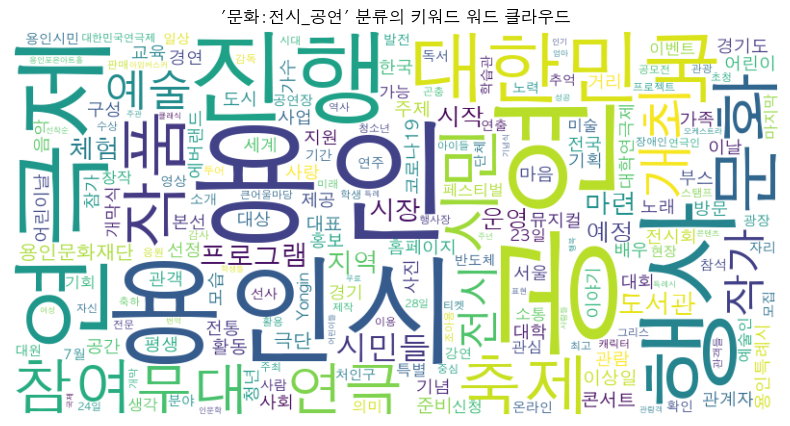

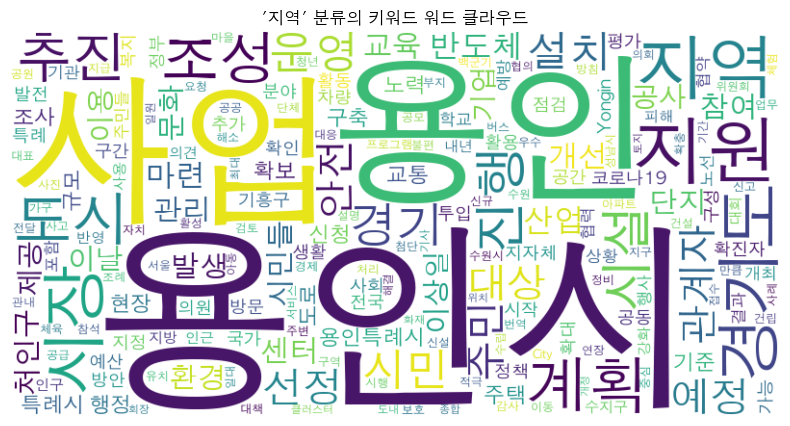

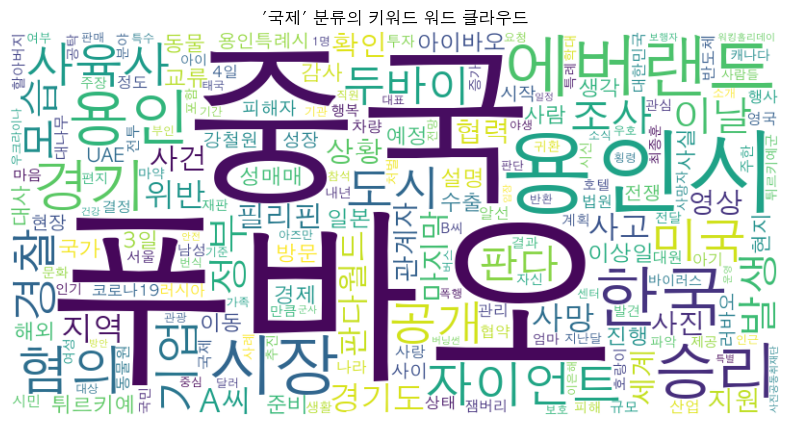

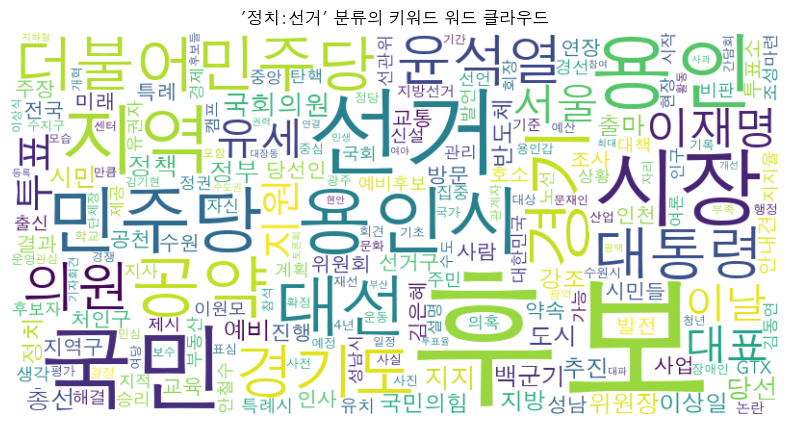

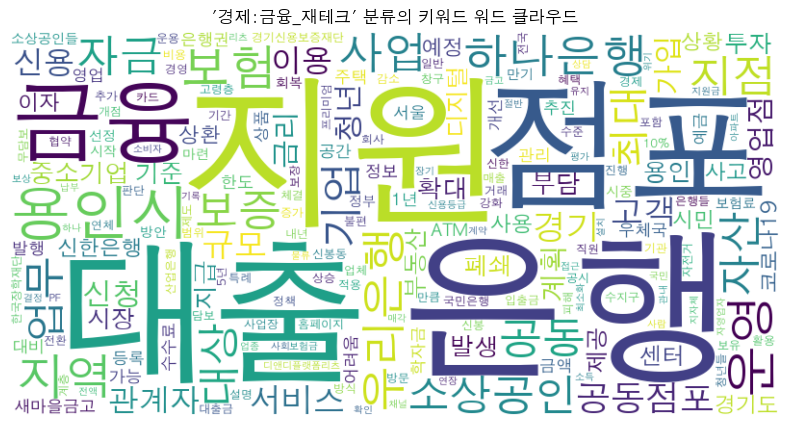

...

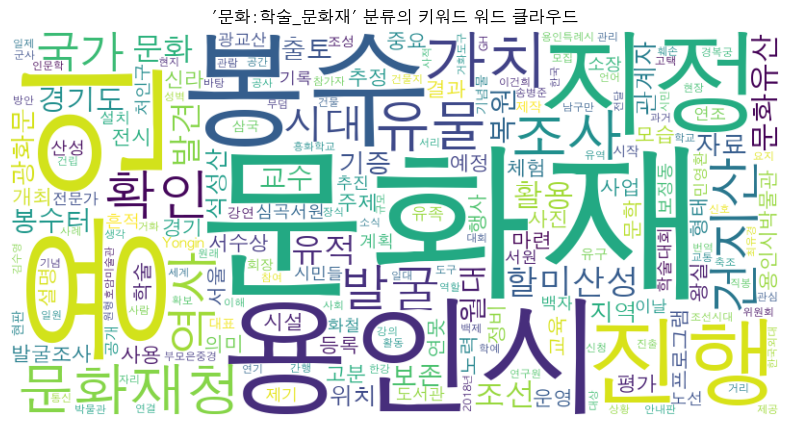

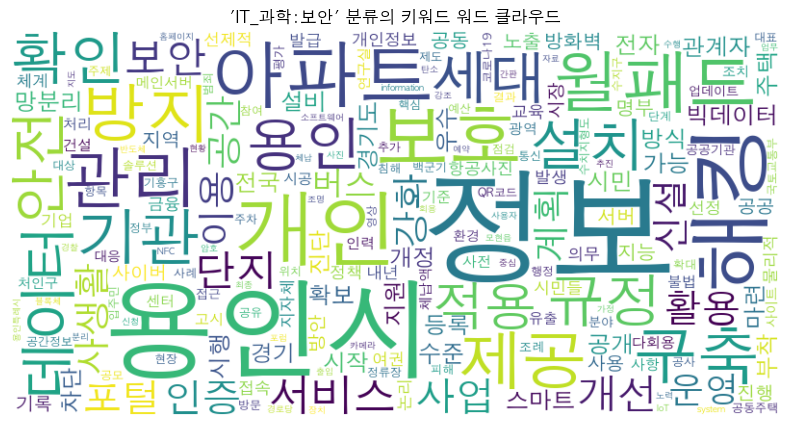

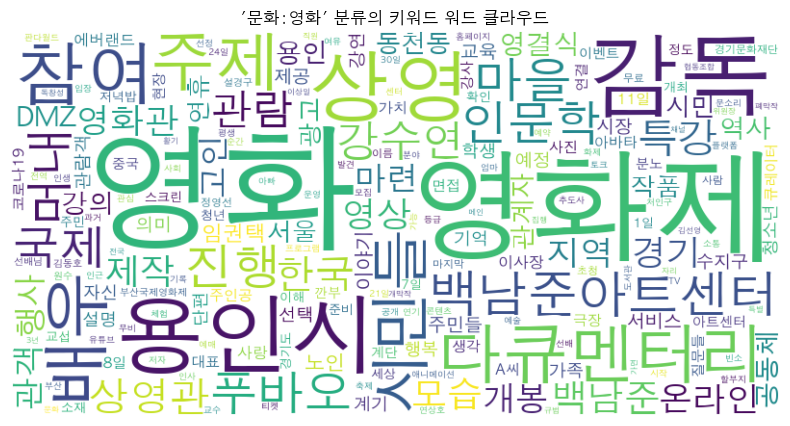

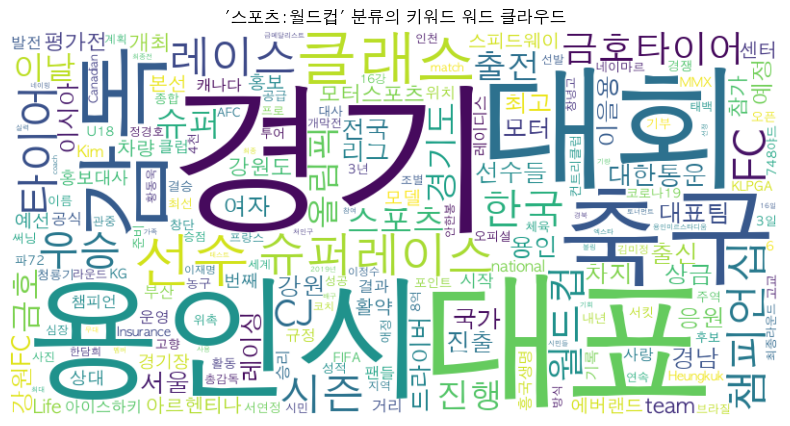

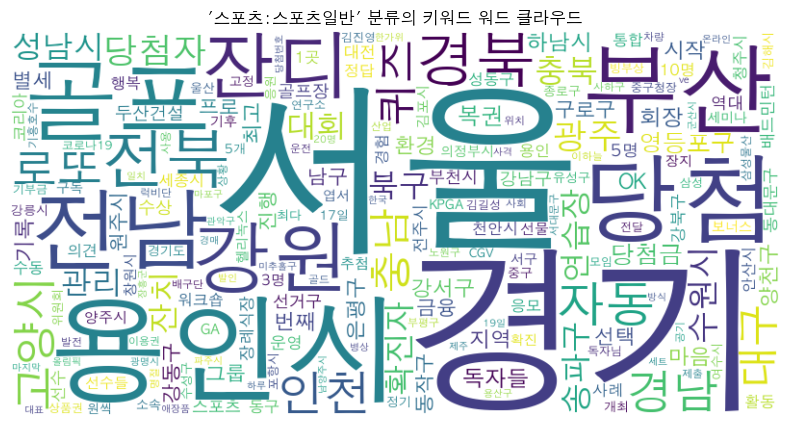

In [95]:
for category in categories:
    generate_wordcloud(train_df, category, font_path)